In [1]:
import numpy as np
import pandas as pd
import functions as fnc
import glob
import os
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from torchvision.ops.boxes import batched_nms
from importlib import reload

from sklearn.neighbors import KDTree
import matplotlib.colors as mcolors
from skimage.measure import label, regionprops
import torch
from skimage.color import label2rgb
from skimage.segmentation import clear_border

import clip
from tqdm import tqdm
from PIL import Image


In [2]:
if torch.cuda.is_available():
    DEVICE = torch.device('cuda:0')
else:
    DEVICE = torch.device('cpu')

def find_bounding_boxes(binary_mask):
    bboxes = []
    binary_mask=torch.tensor(binary_mask, device=DEVICE, dtype=torch.float)
    labels = torch.unique(binary_mask)
    if len(labels)==1:
        return [0,0,1,1]
    for label in labels:
        if label == 0:
            continue  # skip the background
        positions = torch.nonzero(binary_mask == label)
        if positions.numel() == 0:
            continue
        y_min, x_min = positions.min(dim=0)[0]
        y_max, x_max = positions.max(dim=0)[0]
        bboxes.append([x_min.item(), y_min.item(), x_max.item() + 1, y_max.item() + 1])
    return bboxes[0]

In [3]:
#OutDIR='/DATA/vito/output/overlap_highestIOU_reseg_edgenobuffer_downsampled2/'
#downsampled=True
OutDIR='/DATA/vito/output/overlap_highestIOU_reseg_edgenobuffer/'
downsampled=False

DataDIR='/DATA/vito/data/'
#fn_img = glob.glob(DataDIR+'test_img/*')
fn_img = glob.glob(DataDIR+'drone_ortho/*')
fn_img.sort()

image=(np.load(DataDIR+'example/rgb.npy')*255).astype(np.uint8)
#image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
seg_ids=np.load(DataDIR+'example/segment_ids.npy')

if downsampled:
    pre_para={'Downsample': {'fxy':0.5}}
    image=fnc.preprocessing_roulette(image, pre_para)
    pre_para={'Downsample': {'fxy':0.5, 'method':'nearest'}}
    seg_ids=fnc.preprocessing_roulette(seg_ids, pre_para)

all_reseg=np.load(OutDIR+'all_reseg_mask.npy', allow_pickle=True)

In [4]:
Aggregate_masks=[]
pred_iou=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip(clip_window['nms mask'],clip_window['nms mask pred iou']):
        resize=np.zeros(image.shape[:-1])
        Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
        if Valid_area==(crop_size,crop_size):
            resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
        else:
            resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
        Aggregate_masks.append(resize)
        pred_iou.append(score)
stacked_Aggregate_masks=np.sum(Aggregate_masks,axis=0)

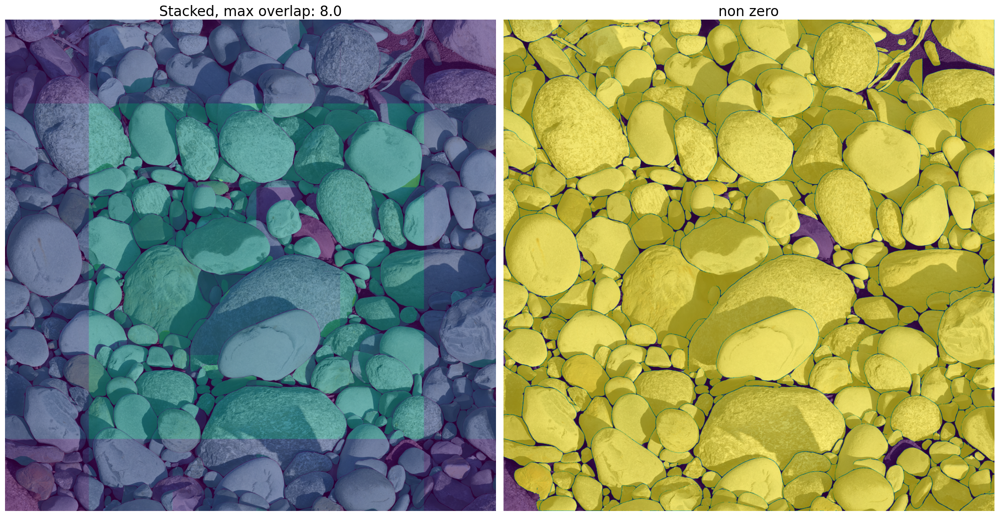

In [5]:
plt.figure(figsize=(20,15))
plt.subplot(1,2,1)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks,alpha=0.6)
plt.axis('off')
plt.title(f'Stacked, max overlap: {np.max(stacked_Aggregate_masks)}', fontsize=20)
plt.subplot(1,2,2)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks!=0,alpha=0.6)
plt.axis('off')
plt.title('non zero', fontsize=20)
plt.tight_layout()
plt.show()

In [6]:
bboxes = torch.tensor([find_bounding_boxes(mask) for mask in Aggregate_masks], device=DEVICE, dtype=torch.float)
scores = torch.tensor(pred_iou, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])
keep = batched_nms(bboxes, scores, labels, 0.3)
Aggregate_masks_nms=[Aggregate_masks[i] for i in keep]
pred_iou_nms=[pred_iou[i] for i in keep]

In [7]:
stacked_Aggregate_masks_nms=np.sum(Aggregate_masks_nms,axis=0)

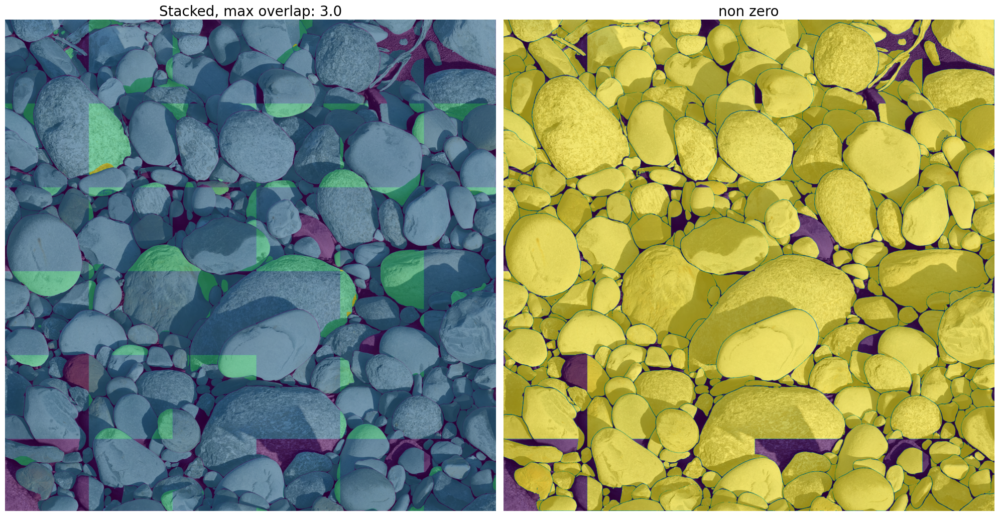

In [8]:
plt.figure(figsize=(20,15))
plt.subplot(1,2,1)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_nms,alpha=0.6)
plt.axis('off')
plt.title(f'Stacked, max overlap: {np.max(stacked_Aggregate_masks_nms)}', fontsize=20)
plt.subplot(1,2,2)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_nms!=0,alpha=0.6)
plt.axis('off')
plt.title('non zero', fontsize=20)
plt.tight_layout()

In [9]:
Aggregate_masks_noedge=[]
pred_iou_noedge=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip(clip_window['mask'], clip_window['mask pred iou']):
        if not (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            resize=np.zeros(image.shape[:-1])
            Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
            if Valid_area==(crop_size,crop_size):
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
            else:
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
            Aggregate_masks_noedge.append(resize)
            pred_iou_noedge.append(score)
#del all_reseg

In [10]:
stacked_Aggregate_masks_noedge=np.sum(Aggregate_masks_noedge,axis=0)

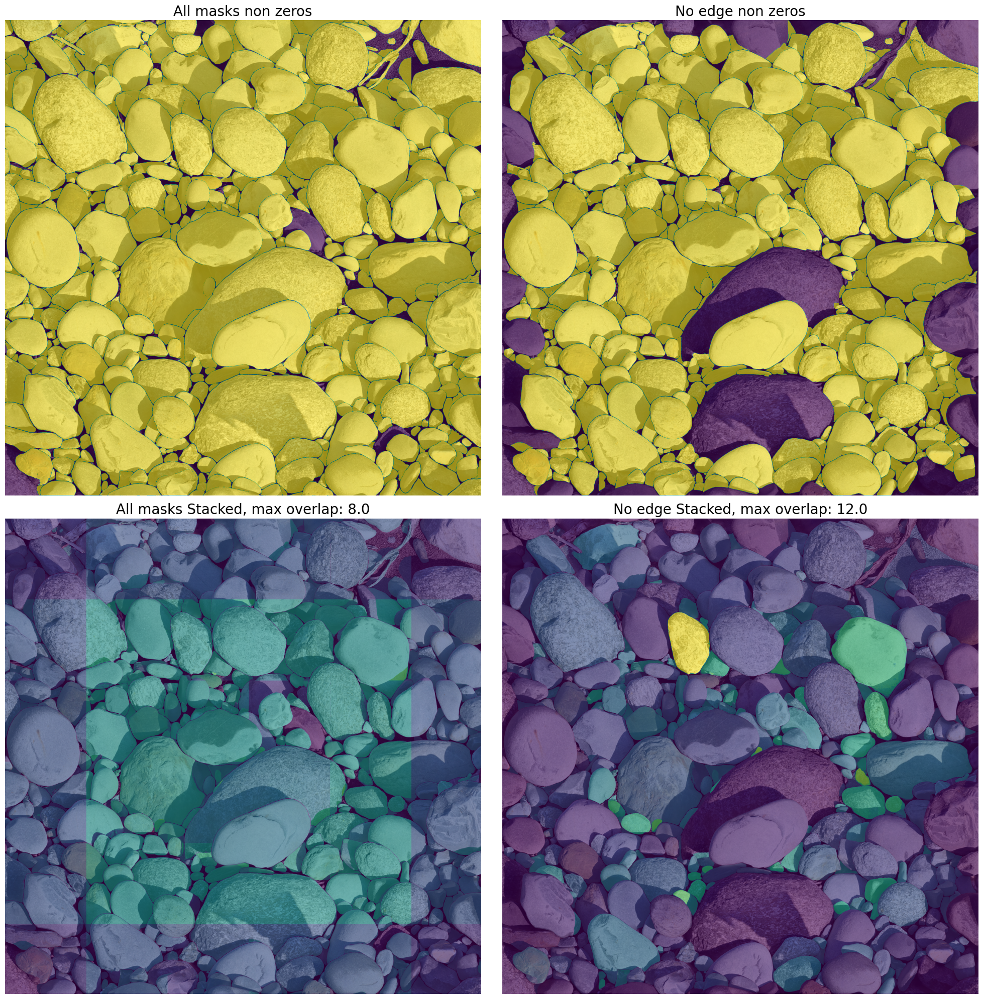

In [11]:
plt.figure(figsize=(20,20))
plt.subplot(2,2,1)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks!=0,alpha=0.6)
plt.axis('off')
plt.title('All masks non zeros', fontsize=20)
plt.subplot(2,2,2)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge!=0,alpha=0.6)
plt.axis('off')
plt.title('No edge non zeros', fontsize=20)
plt.subplot(2,2,3)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks,alpha=0.6)
plt.axis('off')
plt.title(f'All masks Stacked, max overlap: {np.max(stacked_Aggregate_masks)}', fontsize=20)
plt.subplot(2,2,4)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge,alpha=0.6)
plt.axis('off')
plt.title(f'No edge Stacked, max overlap: {np.max(stacked_Aggregate_masks_noedge)}', fontsize=20)
plt.tight_layout()
plt.show()

In [12]:
bboxes = torch.tensor([find_bounding_boxes(mask) for mask in Aggregate_masks_noedge], device=DEVICE, dtype=torch.float)
scores = torch.tensor(pred_iou_noedge, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])

In [13]:
keep = batched_nms(bboxes, scores, labels, 0.35)#was 0.3
Aggregate_masks_noedge_nms=[Aggregate_masks_noedge[i] for i in keep]
pred_iou_noedge_nms=[pred_iou_noedge[i] for i in keep]

In [14]:
stacked_Aggregate_masks_noedge_nms=np.sum(Aggregate_masks_noedge_nms,axis=0)

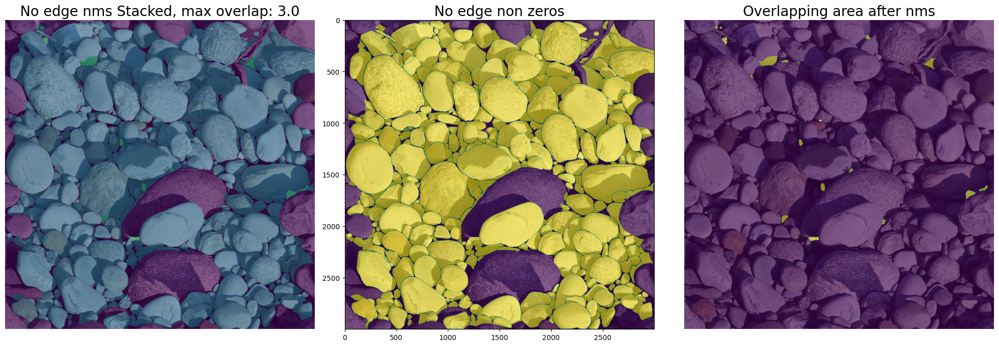

In [15]:
plt.figure(figsize=(20,15))
plt.subplot(1,3,1)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge_nms,alpha=0.6)
plt.axis('off')
plt.title(f'No edge nms Stacked, max overlap: {np.max(stacked_Aggregate_masks_noedge_nms)}', fontsize=20)
plt.subplot(1,3,2)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge_nms!=0,alpha=0.6)
#plt.axis('off')
plt.title('No edge non zeros', fontsize=20)
plt.subplot(1,3,3)
plt.imshow(image)
plt.imshow(stacked_Aggregate_masks_noedge_nms>1,alpha=0.6)
plt.axis('off')
plt.title('Overlapping area after nms', fontsize=20)
plt.tight_layout()
plt.show()

In [16]:
#clear RAM
del pred_iou,bboxes,scores,labels,keep,Aggregate_masks_nms,pred_iou_nms,stacked_Aggregate_masks_nms
del Aggregate_masks,stacked_Aggregate_masks
del Aggregate_masks_noedge, pred_iou_noedge

In [17]:
list_of_mask_centroid = [fnc.get_centroid(mask) for mask in Aggregate_masks_noedge_nms]
ar_masks=np.stack(Aggregate_masks_noedge_nms)
del Aggregate_masks_noedge_nms

In [18]:
from skimage.morphology import binary_dilation
kernel = np.ones((5, 5), np.uint8)
stacked_Aggregate_masks_noedge_nms_eroded=binary_dilation(stacked_Aggregate_masks_noedge_nms>=1, kernel)
 
#stacked_Aggregate_masks_noedge_nms_eroded = cv2.dilate(stacked_Aggregate_masks_noedge_nms==1, kernel, iterations=1) 
no_mask_area=label(stacked_Aggregate_masks_noedge_nms_eroded,1,False,1)

In [19]:
regions=regionprops(no_mask_area)
for i,region in enumerate(regions):
    # take regions with large enough areas
    if (region.area <= 10000):
        no_mask_area[no_mask_area==(i+1)]=0
    else:
        mask=np.array(no_mask_area==(i+1))
        if (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            no_mask_area[no_mask_area==(i+1)]=0
np.unique(no_mask_area)

array([  0, 326, 473], dtype=int32)

In [20]:
flt_no_mask_area=label(no_mask_area)
np.unique(flt_no_mask_area)
del no_mask_area

Text(0.5, 1.0, 'Void in clean SAM masks')

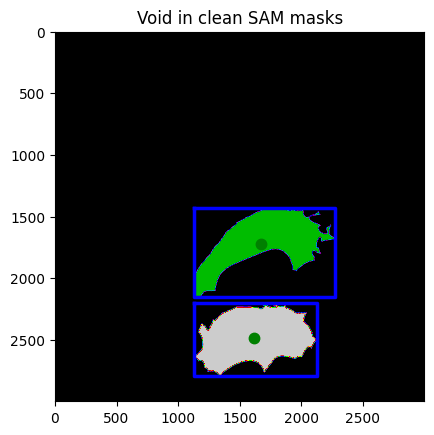

In [45]:
plt.imshow(flt_no_mask_area, cmap='nipy_spectral')
regions=regionprops(flt_no_mask_area)
list_of_no_mask_area_centroid=[]
list_of_no_mask_area_mask=[]
for i,region in enumerate(regions):
    #if i>0:
    y0, x0 =region.centroid
    list_of_no_mask_area_centroid.append((y0,x0))
    list_of_no_mask_area_mask.append(flt_no_mask_area==(i+1))
    
    plt.plot(x0, y0, '.g', markersize=15)
    minr, minc, maxr, maxc = region.bbox
    bx = (minc, maxc, maxc, minc, minc)
    by = (minr, minr, maxr, maxr, minr)
    plt.plot(bx, by, '-b', linewidth=2.5)
ar_no_mask_area=np.stack(list_of_no_mask_area_mask)
plt.title('Void in clean SAM masks')


In [22]:
#fill in holes with downsampled segmentation
OutDIR='/DATA/vito/output/overlap_highestIOU_reseg_edgenobuffer_downsampled2/'
all_reseg=np.load(OutDIR+'all_reseg_mask.npy', allow_pickle=True)
image=(np.load(DataDIR+'example/rgb.npy')*255).astype(np.uint8)
fxy=0.5
pre_para={'Downsample': {'fxy':fxy}}
image_dw=fnc.preprocessing_roulette(image, pre_para)

Aggregate_masks_noedge=[]
pred_iou_noedge=[]
crop_size=1024
for clip_window in all_reseg:
    i=clip_window['i']
    j=clip_window['j']
    for mask,score in zip(clip_window['mask'], clip_window['mask pred iou']):
        if not (np.any(mask[0]==1) or np.any(mask[-1]==1) or np.any(mask[:,0]==1) or np.any(mask[:,-1]==1)):
            resize=np.zeros(image_dw.shape[:-1])
            Valid_area=resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)].shape
            if Valid_area==(crop_size,crop_size):
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask
            else:
                resize[int(crop_size*i):int(crop_size*i+crop_size),int(crop_size*j):int(crop_size*j+crop_size)]=mask[:Valid_area[0],:Valid_area[1]]
            Aggregate_masks_noedge.append(resize)
            pred_iou_noedge.append(score)

#nms       
bboxes = torch.tensor([find_bounding_boxes(mask) for mask in Aggregate_masks_noedge], device=DEVICE, dtype=torch.float)
scores = torch.tensor(pred_iou_noedge, device=DEVICE, dtype=torch.float)
labels = torch.zeros_like(bboxes[:, 0])

keep = batched_nms(bboxes, scores, labels, 0.35)#was 0.3
Aggregate_masks_noedge_nms=[Aggregate_masks_noedge[i] for i in keep]
del Aggregate_masks_noedge, pred_iou_noedge

#finding best matching centroid
list_of_mask_centroid_dw = [fnc.get_centroid(mask) for mask in Aggregate_masks_noedge_nms]
ar_masks_dw=np.stack(Aggregate_masks_noedge_nms)
del Aggregate_masks_noedge_nms

list_of_no_mask_area_centroid_dw=[]
for y,x in list_of_no_mask_area_centroid:
    list_of_no_mask_area_centroid_dw.append((y*fxy,x*fxy))

tree = KDTree(list_of_no_mask_area_centroid_dw+list_of_mask_centroid_dw)              
k=6
_, ind = tree.query(list_of_no_mask_area_centroid_dw, k=k)

# get nearest centroid iou
kdc_iou=[]
nearest_mask_pick=[]
labelcount=ar_no_mask_area.shape[0]
for match in ind:
    #check if nearest neighbor is not a label
    j=1
    while match[j]<labelcount:
        j+=1
        if j==k:
            break
    if j<k:
        matching_mask=fnc.downsample_fnc(ar_masks_dw[match[j]-labelcount],{'fxy':2}).astype(int)
        if np.sum(ar_no_mask_area[match[0]])>np.sum(matching_mask):
            kdc_iou.append(-fnc.iou(ar_no_mask_area[match[0]],matching_mask))
            nearest_mask_pick.append(matching_mask)
        else:
            kdc_iou.append(fnc.iou(ar_no_mask_area[match[0]],matching_mask))
            nearest_mask_pick.append(matching_mask)
    else:
        kdc_iou.append(-0.1)
        nearest_mask_pick.append(0)
        
del ar_masks_dw, all_reseg,list_of_mask_centroid_dw

In [23]:
ar_masks=np.vstack((ar_masks,np.stack(nearest_mask_pick)))
list_of_mask_centroid = [fnc.get_centroid(ar_masks[i]) for i in range(ar_masks.shape[0])]


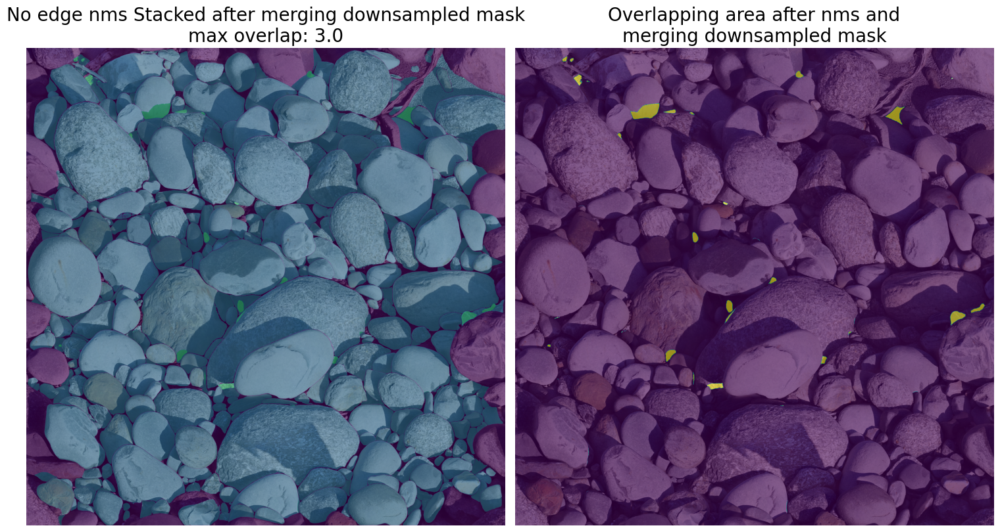

In [24]:
plt.figure(figsize=(15,10))
plt.subplot(1,2,1)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0),alpha=0.6)
plt.axis('off')
plt.title(f'No edge nms Stacked after merging downsampled mask\nmax overlap: {np.max(np.sum(ar_masks,axis=0))}', fontsize=20)
plt.subplot(1,2,2)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0)>1,alpha=0.6)
plt.axis('off')
plt.title('Overlapping area after nms and\nmerging downsampled mask', fontsize=20)
plt.tight_layout()
plt.show()

In [25]:
seg_labels=(np.unique(seg_ids)[1:])

seg_size=[]
for seg in seg_labels:
    seg_size.append(np.sum(seg_ids==seg))

seg_size_sort_idx=np.argsort(seg_size)

list_of_label=[(seg_ids==seg_labels[index]).astype(np.uint8) for index in seg_size_sort_idx]
list_of_label_centroid = [fnc.get_centroid(mask) for mask in list_of_label]
ar_label=np.stack(list_of_label)
del list_of_label

#ar_all=np.stack(list_of_label+Aggregate_masks_noedge_nms)
#list_of_centroid = [fnc.get_centroid(ar_all[i]) for i in range(len(ar_all))]

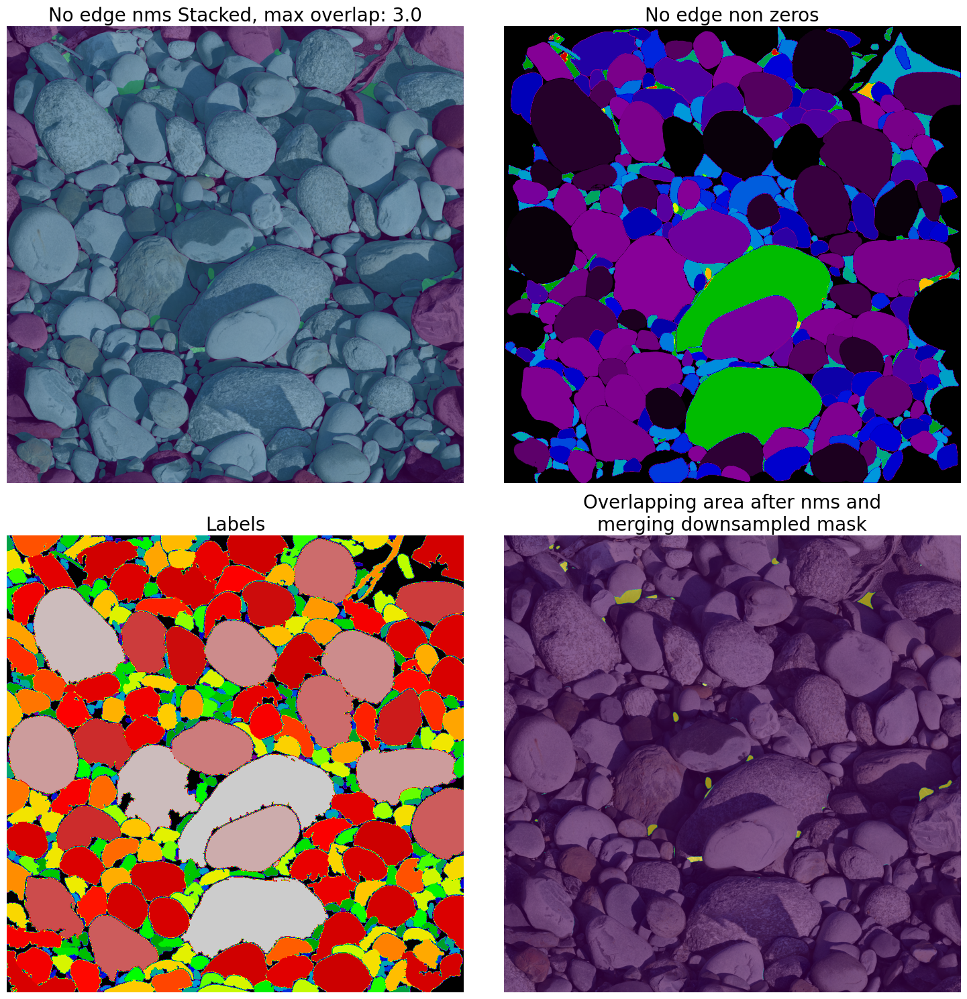

In [30]:
plt.figure(figsize=(15,15))
plt.subplot(2,2,1)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0),alpha=0.6)
plt.axis('off')
plt.title(f'No edge nms Stacked, max overlap: {np.max(np.sum(ar_masks,axis=0))}', fontsize=20)

plt.subplot(2,2,2)
plt.imshow(image)
plt.imshow(np.sum([ar_masks[i]*(i+1) for i in range(ar_masks.shape[0])],axis=0), cmap='nipy_spectral')
plt.axis('off')
plt.title('No edge non zeros', fontsize=20)

plt.subplot(2,2,3)
plt.imshow(image)
plt.imshow(np.sum([ar_label[i]*(i+1) for i in range(ar_label.shape[0])],axis=0), cmap='nipy_spectral')
plt.axis('off')
plt.title('Labels', fontsize=20)

plt.subplot(2,2,4)
plt.imshow(image)
plt.imshow(np.sum(ar_masks,axis=0)>1,alpha=0.6)
plt.axis('off')
plt.title('Overlapping area after nms and\nmerging downsampled mask', fontsize=20)

plt.tight_layout()
plt.show()

In [27]:
tree = KDTree(list_of_label_centroid+list_of_mask_centroid)              
k=6
_, ind = tree.query(list_of_label_centroid, k=k)

# get nearest centroid iou
kdc_iou=[]
nearest_mask_pick=[]
labelcount=ar_label.shape[0]
for match in ind:
    #check if nearest neighbor is not a label
    j=1
    while match[j]<labelcount:
        j+=1
        if j==k:
            break
    if j<k:
        if np.sum(ar_label[match[0]])>np.sum(ar_masks[match[j]-labelcount]):
            kdc_iou.append(-fnc.iou(ar_label[match[0]],ar_masks[match[j]-labelcount]))
            nearest_mask_pick.append(match[j])
        else:
            kdc_iou.append(fnc.iou(ar_label[match[0]],ar_masks[match[j]-labelcount]))
            nearest_mask_pick.append(match[j])
    else:
        kdc_iou.append(-0.1)
        nearest_mask_pick.append(0)

In [ ]:
labels_exclude_edge=[]
labels_exclude_edge_idx=[]
for i in range(len(ar_label)):
    if (np.any(ar_label[i][0]==1) or np.any(ar_label[i][-1]==1) or np.any(ar_label[i][:,0]==1) or np.any(ar_label[i][:,-1]==1)):
        labels_exclude_edge.append(False)
    else:
        labels_exclude_edge.append(True)
        labels_exclude_edge_idx.append(i)

fig,ax=plt.subplots(2,1,figsize=(20,15))
ax=ax.flatten()
mean=np.mean(np.array(nearest_centroid_distance)[labels_exclude_edge])
ax[0].scatter(sizes[labels_exclude_edge],np.array(nearest_centroid_distance)[labels_exclude_edge]
            ,label=f'centroid distance (mean: {mean:.2f})')
ax[0].set_ylim(top=150)
ax[0].set_xlabel('grain size (log)', fontsize=20)
ax[0].set_ylabel('distance (px)', fontsize=20)
ax[0].grid()
ax[0].legend()
#ax[1].scatter(np.log10([seg_size[i] for i in seg_size_sort_idx]),avg_iou,label='average iou')
ax[1].scatter(sizes[labels_exclude_edge],max_iou[labels_exclude_edge]
            ,label=f'max iou (abs mean: {round(np.mean(np.abs(max_iou)[labels_exclude_edge]),2)})')
ax[1].scatter(sizes[labels_exclude_edge],kdc_iou[labels_exclude_edge]
            ,label=f'nearest neighbour (mean: {round(np.mean(np.array(kdc_iou)[labels_exclude_edge]),2)})')
ax[1].set_xlabel('grain size (log)', fontsize=20)
ax[1].set_ylabel('iou', fontsize=20)
ax[1].grid()
ax[1].legend()
ax[0].set_title(f'Clip: i{ii},j{ji} Excluding edge objects', fontsize=20)
#plt.savefig(OutDIR+f'clip_{ii}{ji}_dist_iou_plot_noedge.png')
plt.show()

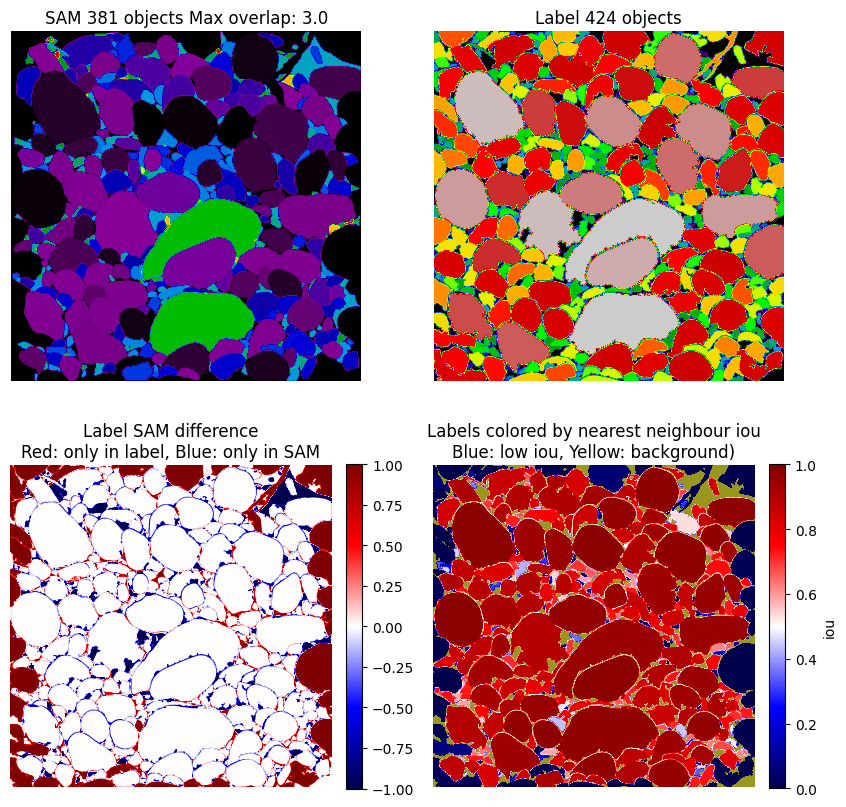

In [28]:
plt.figure(figsize=(10,10))
plt.subplot(2,2,1)
plt.imshow(np.sum([ar_masks[i]*(i+1) for i in range(ar_masks.shape[0])],axis=0), cmap='nipy_spectral')
plt.title(f'SAM {ar_masks.shape[0]} objects Max overlap: {np.max(np.sum(ar_masks,axis=0))}')
plt.axis('off')
plt.subplot(2,2,2)
plt.imshow(np.sum([ar_label[i]*(i+1) for i in range(labelcount)],axis=0), cmap='nipy_spectral')
plt.title(f'Label {labelcount} objects')
plt.axis('off')
plt.subplot(2,2,3)
plt.imshow(np.sum(ar_label,axis=0).astype(np.int64)-np.sum(ar_masks,axis=0).astype(np.int64),cmap='seismic',vmax=1,vmin=-1)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Label SAM difference\nRed: only in label, Blue: only in SAM')
plt.axis('off')

plt.subplot(2,2,4)
ar_label_iou=ar_label.copy().astype(np.float64)
for i,x in enumerate(kdc_iou):
    ar_label_iou[i]=ar_label[i]*x

mask = np.isclose(np.sum(ar_label,axis=0),0)
plt.imshow(np.abs(np.sum(ar_label_iou,axis=0)), cmap='seismic',vmax=1,vmin=0)
plt.colorbar(label='iou',fraction=0.046, pad=0.04)
cmap = mcolors.ListedColormap(['none', 'yellow'])
plt.imshow(mask, cmap=cmap, alpha=0.6)
plt.axis('off')
plt.title('Labels colored by nearest neighbour iou\nBlue: low iou, Yellow: background)')
plt.show()

In [32]:
nearest_centroid_distance=[]
for i in range(labelcount):
    if nearest_mask_pick[i]!=0:
        x0,y0=list_of_label_centroid[i]#label centroid
        x1,y1=list_of_mask_centroid[nearest_mask_pick[i]-labelcount]
        nearest_centroid_distance.append(np.sqrt((x0-x1)**2+(y0-y1)**2))
    else:
        nearest_centroid_distance.append(np.nan)
        print('one nan')

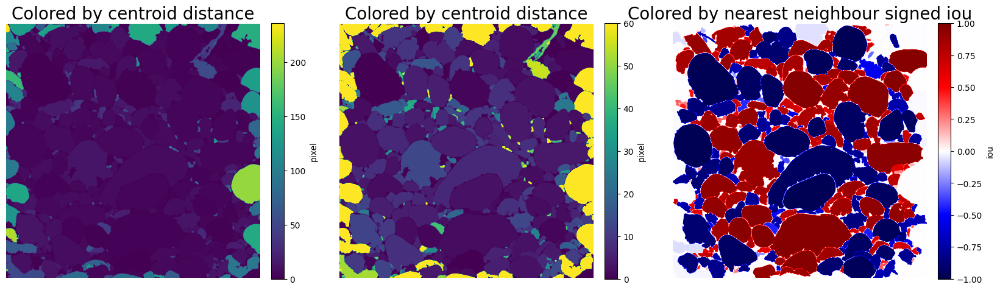

In [33]:
plt.figure(figsize=(20,15))
plt.subplot(1,3,1)
ar_label_dist=ar_label.copy()
for i,x in enumerate(nearest_centroid_distance):
    if not np.isnan(x):
        ar_label_dist[i]=ar_label_dist[i]*x
    else:
        ar_label_dist[i]=ar_label_dist[i]*(-9999)
plt.imshow(np.sum(ar_label_dist,axis=0),vmin=0)
plt.colorbar(label='pixel',fraction=0.046, pad=0.04)
cmap = mcolors.ListedColormap(['none', 'red'])
mask = np.isclose(np.sum(ar_label,axis=0),-9999)
plt.imshow(mask, cmap=cmap)
plt.axis('off')
plt.title('Colored by centroid distance', fontsize=20)

plt.subplot(1,3,2)
plt.imshow(np.sum(ar_label_dist,axis=0),vmax=60)
plt.colorbar(label='pixel',fraction=0.046, pad=0.04)
cmap = mcolors.ListedColormap(['none', 'red'])
mask = np.isclose(np.sum(ar_label,axis=0),-9999)
plt.imshow(mask, cmap=cmap)
plt.axis('off')
plt.title('Colored by centroid distance', fontsize=20)
del ar_label_dist

plt.subplot(1,3,3)
ar_label_iou=ar_label.copy().astype(np.float64)
for i,x in enumerate(kdc_iou):
    ar_label_iou[i]=ar_label[i]*x
plt.imshow(np.sum(ar_label_iou,axis=0), cmap='seismic',vmax=1,vmin=-1)
plt.colorbar(label='iou',fraction=0.046, pad=0.04)
plt.axis('off')
plt.title('Colored by nearest neighbour signed iou', fontsize=20)
plt.show()

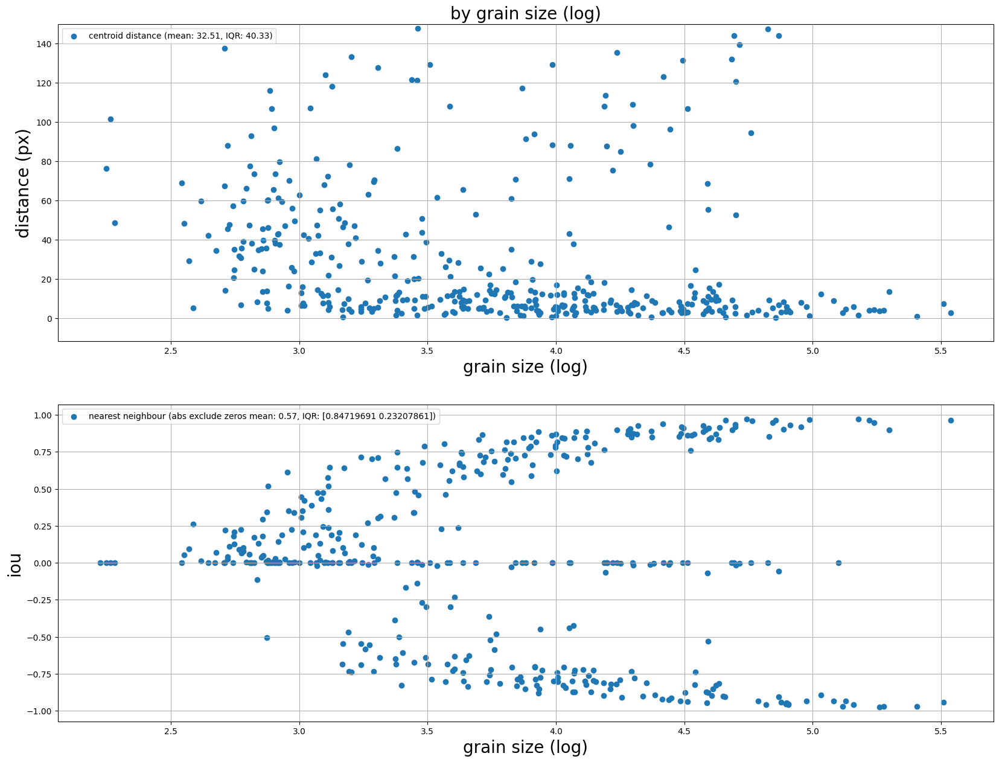

In [44]:
kdc_iou=np.array(kdc_iou)
sizes=np.log10([seg_size[i] for i in seg_size_sort_idx])

fig,ax=plt.subplots(2,1,figsize=(20,15))
ax=ax.flatten()
ax[0].scatter(sizes,np.array(nearest_centroid_distance),label=f'centroid distance (mean: {np.nanmean(nearest_centroid_distance):.2f}, IQR: {np.subtract(*np.percentile(nearest_centroid_distance, [75, 25])):.2f})')
ax[0].set_ylim(top=150)
ax[0].set_xlabel('grain size (log)', fontsize=20)
ax[0].set_ylabel('distance (px)', fontsize=20)
ax[0].grid()
ax[0].legend()
ax[1].scatter(sizes,kdc_iou,label=f'nearest neighbour (abs exclude zeros mean: {round(np.mean(np.abs(kdc_iou[kdc_iou!=0])),2)}, IQR: {np.percentile(np.abs(kdc_iou[kdc_iou!=0]), [75, 25])})')
ax[1].set_xlabel('grain size (log)', fontsize=20)
ax[1].set_ylabel('iou', fontsize=20)
ax[1].grid()
ax[1].legend()
ax[0].set_title('by grain size (log)', fontsize=20)
plt.show()

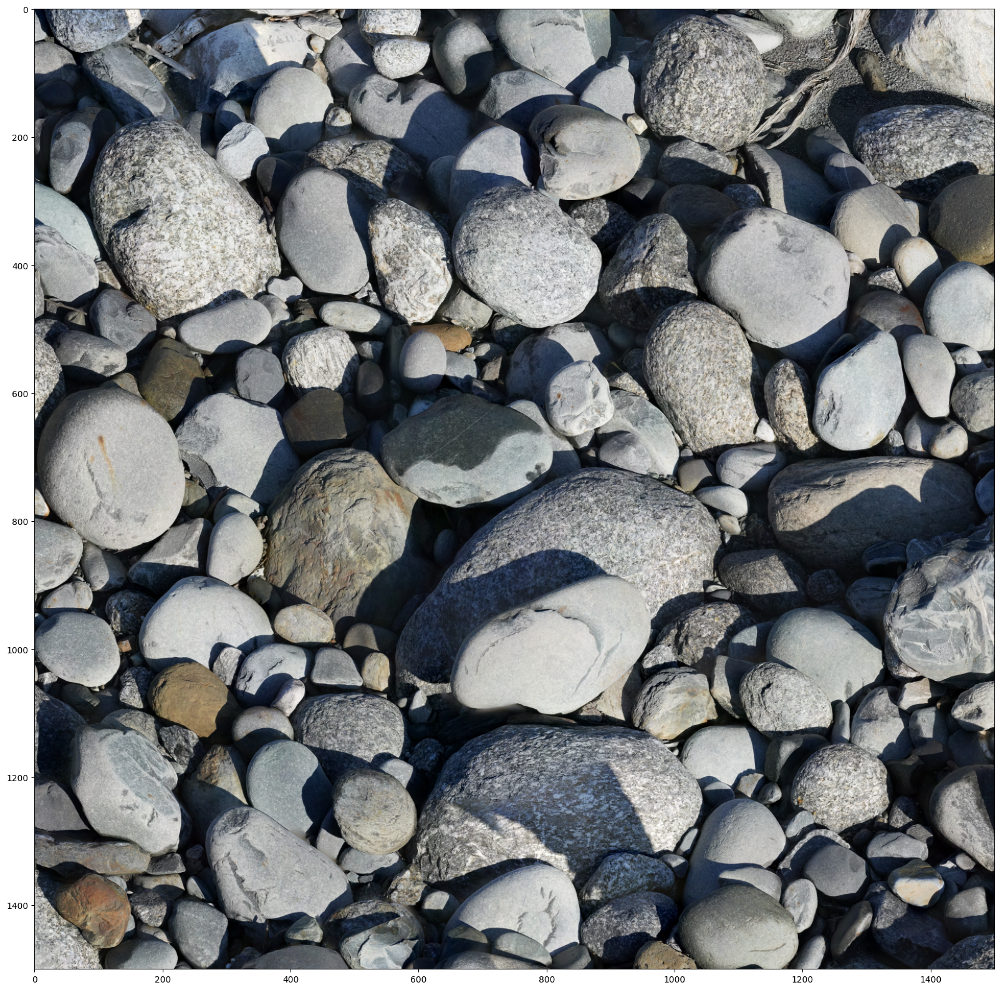

In [39]:
plt.figure(figsize=(20,20))
plt.imshow(image)

In [40]:
#clip

model_list=clip.available_models()
print('Available clip models:')
for i, M in enumerate(model_list):
    print(f'{i}:' + M)
print("---------------")

Available clip models:
0:RN50
1:RN101
2:RN50x4
3:RN50x16
4:RN50x64
5:ViT-B/32
6:ViT-B/16
7:ViT-L/14
8:ViT-L/14@336px
---------------


In [41]:
#model_select=int(input("Select a model: "))
model_select=7
model, preprocess = clip.load(model_list[model_select], device=DEVICE)
print(model_list[model_select]+' loaded')

ViT-L/14 loaded


In [42]:
kmean_mask=np.array(np.reshape(cluster_labels,(crop_size,crop_size)) == 0)
kmean_masked_img=cropped_image.copy()
kmean_masked_img[kmean_mask==0]=0

NameError: name 'cluster_labels' is not defined

In [ ]:
labels_LSet01=["an aerial photo of a stone", "an aerial photo of a small pebble stone"
        , "an aerial photo of a piece of sand surface"
        , "an aerial photo of some green plants", "dead bush"
        , "an aerial photo of a shrub","an irregular green object", "a top-down photo of a bush", "an aerial photo of a bush"
        , "a top-down photo of a shrub", "an aerial photo of some bushes", "wood stick", "wood branch"
        , "an aerial photo of desert surface", "an aerial photo of a sandy ground"
        , "a photo of the top of a bush", "an aerial photo of a small bush"]

In [ ]:
labels_LSet01=["a photo of a stone", "a photo of a wood stick","wood branch"]

In [43]:
##label top

kmean_apply=False
WithBackground=False
BG='White'
#BG='Black

if (not WithBackground) or kmean_apply:
    if BG=='White':
        fill_value=255
    else:
        fill_value=0

#load image
pil_image = Image.fromarray(image)
numpy_array = np.array(pil_image)
if kmean_apply:
    numpy_array[kmean_mask==0]=fill_value

#define possible labels
labels=["a photo of a stone", "a photo of a wood stick","wood branch"]
text = clip.tokenize(labels).to(DEVICE)

#output
most_probables = []
probabilities = []
clip_probability_mask=np.zeros(image.shape[:-1])
    
#run prediction
for sg in tqdm(range(ar_masks.shape[0]), desc='Processing', unit='segment'):
    sg_mask=ar_masks[sg]
    
    #cropping
    notzero_indices = np.nonzero(sg_mask)
    if notzero_indices[0].shape[0]>10:
        x_min = np.min(notzero_indices[0]).astype(int)
        x_max = np.max(notzero_indices[0]).astype(int)
        y_min = np.min(notzero_indices[1]).astype(int)
        y_max = np.max(notzero_indices[1]).astype(int)
        if WithBackground:
            clip_masked_image=numpy_array[x_min-5:x_max+5, y_min-5:y_max+5,:]
        else:
            #masking
            masked_image = np.copy(numpy_array)
            masked_image[sg_mask == 0] = fill_value
            clip_masked_image=masked_image[x_min-5:x_max+5, y_min-5:y_max+5,:]

        #convert back to PIL
        if ((clip_masked_image.shape[0]!=0)&(clip_masked_image.shape[1]!=0)):
            preprocessed_pil_image = Image.fromarray(clip_masked_image)

            #predict
            pre_image = preprocess(preprocessed_pil_image).unsqueeze(0).to(DEVICE)
            most_porbable, probability = fnc.classify_and_return_notable(pre_image, text, labels, model)
            most_probables.append(int(most_porbable))
            probabilities.append(probability)
            
            if int(most_porbable)<=1:
                clip_probability_mask[sg_mask!=0]=probability
        else:
            most_probables.append(np.nan)
            probabilities.append(np.nan)

Processing:   0%|          | 0/228 [00:00<?, ?segment/s]

/DATA/vito/.venv/lib/python3.8/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
Processing: 100%|██████████| 228/228 [00:19<00:00, 11.85segment/s]


In [44]:
non_rocks_mask=[ar_masks[i] for i in range(ar_masks.shape[0]) if most_probables[i]!=0]

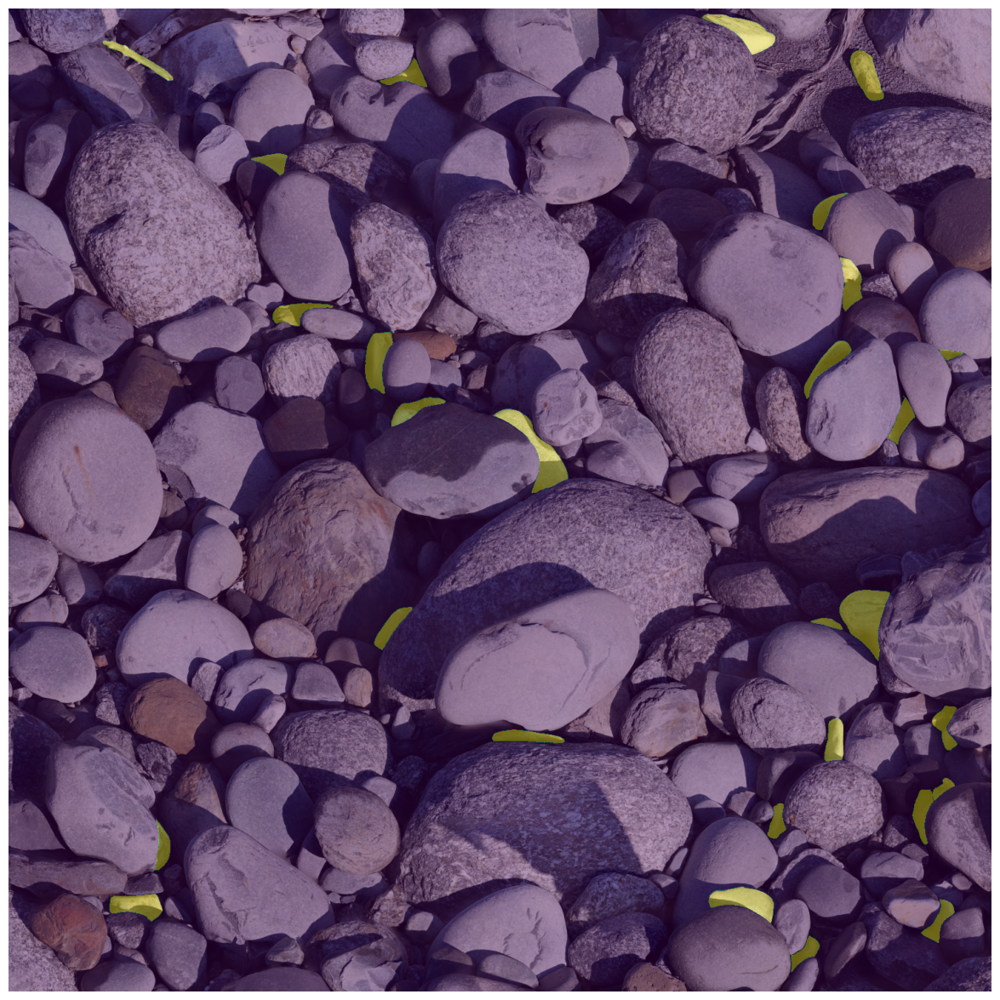

In [45]:
plt.figure(figsize=(15,15))
plt.imshow(image)
plt.imshow(np.sum(non_rocks_mask,axis=0),alpha=0.4)
plt.axis('off')
plt.show()

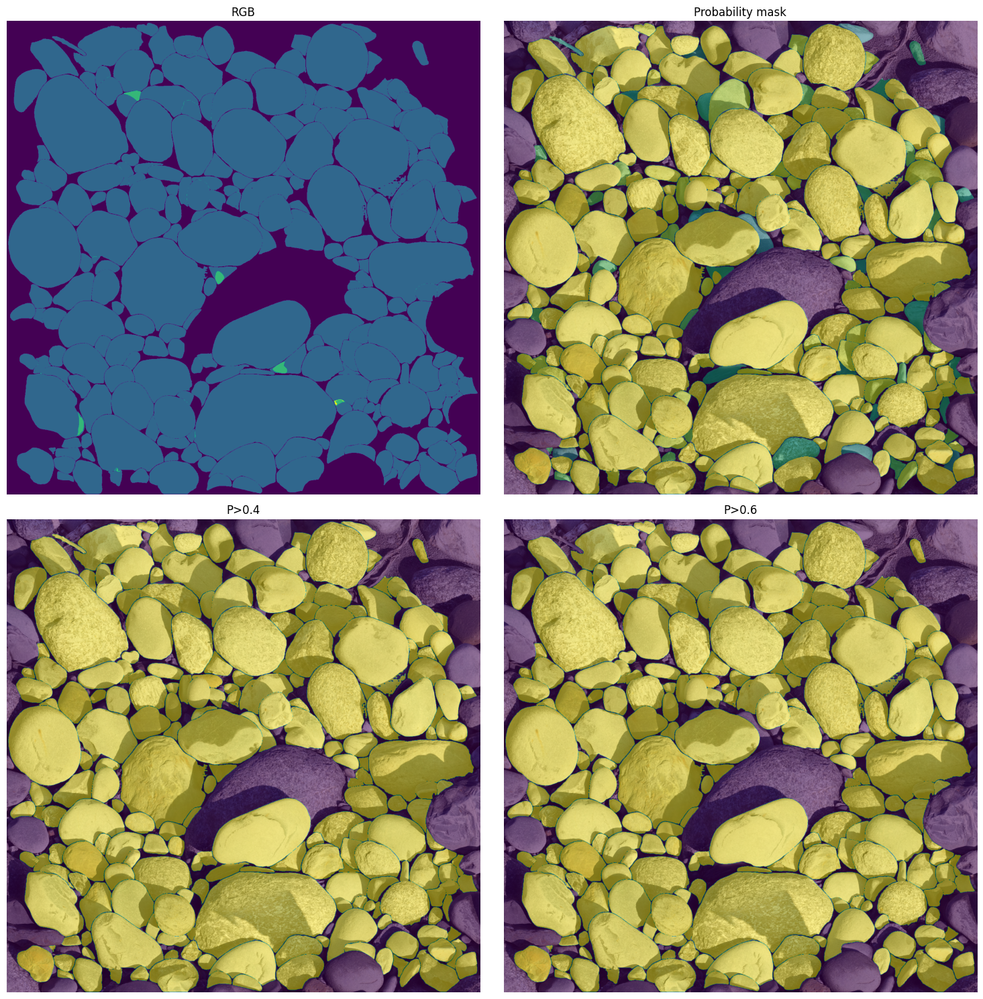

In [46]:
fnc.clip_plotting_array(image,clip_probability_mask, ar_masks,0.4,0.6)